# Código de Mask R-CNN modificado por Daniel Cay



The MIT License (MIT)

Copyright (c) 2017 Matterport, Inc.

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN
THE SOFTWARE.



In [1]:
import os
import sys
import random
import math
import numpy as np
import skimage.io
import matplotlib
import matplotlib.pyplot as plt
from keras import backend as K
import tensorflow as tf
from numpy import asarray
from numpy import savetxt

# paquetes para el tracker
import imutils
import time
import cv2

# Root directory of the project
ROOT_DIR = os.path.abspath("../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize, metricas, obtenerMascaras, io, training

# Import COCO config
sys.path.append(os.path.join(ROOT_DIR, "samples/coco/"))  # To find local version
import coco

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

# Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "images")

Using TensorFlow backend.
/Users/danielcaydelgado/opt/anaconda3/envs/MaskRCNN/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/Users/danielcaydelgado/opt/anaconda3/envs/MaskRCNN/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/Users/danielcaydelgado/opt/anaconda3/envs/MaskRCNN/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dt

In [2]:
version=0

## Configurations

We'll be using a model trained on the MS-COCO dataset. The configurations of this model are in the ```CocoConfig``` class in ```coco.py```.

For inferencing, modify the configurations a bit to fit the task. To do so, sub-class the ```CocoConfig``` class and override the attributes you need to change.

In [3]:
if version==0:
    class InferenceConfig(coco.CocoConfig):
        # Set batch size to 1 since we'll be running inference on
        # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
        GPU_COUNT = 1
        IMAGES_PER_GPU = 1
elif version==1:
    sys.path.append(os.path.join(ROOT_DIR, "samples"))  # To find local version
    import COCO_cars
    class InferenceConfig(COCO_cars.CarsConfig):
        # Set batch size to 1 since we'll be running inference on
        # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
        GPU_COUNT = 1
        IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                93
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

## Create Model and Load Trained Weights

In [4]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
if version==0:
    model.load_weights(COCO_MODEL_PATH, by_name=True)

#Cargar la época que mas interesa (mejor loss mirando con tensorboard)
elif version==1:
    CARS_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_cars_0019.h5")
    model.load_weights(CARS_MODEL_PATH, by_name=True)









Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
box_ind is deprecated, use box_indices instead


Instructions for updating:
Use `tf.cast` instead.


## Class Names

The model classifies objects and returns class IDs, which are integer value that identify each class. Some datasets assign integer values to their classes and some don't. For example, in the MS-COCO dataset, the 'person' class is 1 and 'teddy bear' is 88. The IDs are often sequential, but not always. The COCO dataset, for example, has classes associated with class IDs 70 and 72, but not 71.

To improve consistency, and to support training on data from multiple sources at the same time, our ```Dataset``` class assigns it's own sequential integer IDs to each class. For example, if you load the COCO dataset using our ```Dataset``` class, the 'person' class would get class ID = 1 (just like COCO) and the 'teddy bear' class is 78 (different from COCO). Keep that in mind when mapping class IDs to class names.

To get the list of class names, you'd load the dataset and then use the ```class_names``` property like this.
```
# Load COCO dataset
dataset = coco.CocoDataset()
dataset.load_coco(COCO_DIR, "train")
dataset.prepare()

# Print class names
print(dataset.class_names)
```

We don't want to require you to download the COCO dataset just to run this demo, so we're including the list of class names below. The index of the class name in the list represent its ID (first class is 0, second is 1, third is 2, ...etc.)

In [5]:
# COCO Class names
# Index of the class in the list is its ID. For example, to get ID of
# the teddy bear class, use: class_names.index('teddy bear')
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

In [6]:
#model.keras_model.summary()

In [7]:
import keras 
from keras import backend as K
from keras.models import Sequential,Model
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, Input, concatenate, Activation, Subtract

from keras.optimizers import Adam
from keras.metrics import categorical_crossentropy
from keras.losses import binary_crossentropy


#(14,14,256)->(1,1,256)
def bloqueReduccion(in1,in2):
    x1=Conv2D(256, (5, 5), strides=(2,2))
    x2=BatchNormalization()
    x3=Activation('relu')
    x4=Conv2D(256, (5, 5))
    x5=BatchNormalization()
    x6=Activation('relu')
    
    #objeto 1
    ob1=x1(in1)
    ob1=x2(ob1)
    ob1=x3(ob1)
    ob1=x4(ob1)
    ob1=x5(ob1)
    ob1=x6(ob1)
    
    #objeto 2
    ob2=x1(in2)
    ob2=x2(ob2)
    ob2=x3(ob2)
    ob2=x4(ob2)
    ob2=x5(ob2)
    ob2=x6(ob2)
    
    return ob1,ob2

def createModel():

    in1 = Input(shape=(14,14,256))
    in2 = Input(shape=(14,14,256))

    #(1,1,256)->(256)
    reduccion_in1,reduccion_in2 = bloqueReduccion(in1,in2)
    reduccion_in1 = Flatten()(reduccion_in1)
    reduccion_in2 = Flatten()(reduccion_in2)

    #(reduccion_in1-reduccion_in2)
    z = Subtract()([reduccion_in1, reduccion_in2])

    z=Dense(256, activation='relu')(z)
    z=Dense(128, activation='relu')(z)
    z=Dense(64, activation='relu')(z)
    z=Dense(1, activation='sigmoid')(z)

    modelRAM = Model(inputs=[in1,in2], outputs=[z])

    modelRAM.compile(Adam(lr=.0001), loss='binary_crossentropy', metrics=['accuracy'])
    
    return modelRAM




## Run Object Detection

In [8]:
def frameConGt(i,DATASET):
    return (DATASET!='0006' and DATASET!='0007' and DATASET!='0009') or (DATASET=='0006' and i!=240) or (DATASET=='0007' and (i<27 or i>34) and i!=257 and (i<323 or i>335) and (i<565 or i>602)) or (DATASET=='0009' and (i<299 or i>318))

#0=tracking con alg hungaro / 1=tracking con 0+info capas
def tracking(modelRAM,DATASET,inicio,fin,pesoMask,pesoRAM,umbral,pruebas,metricasTotal,verbose):
    i=inicio
    primeraVez=True

    #lista de objetos visualizados entre todos los frames analizados
    objetos=[]
    #de los objetos visualizados mostrar los que aparecen en el frame actual
    #contiene los id de donde esta dicho objeto en la lista 'objetos'
    objetosFrame=[]
    #identificador único de un objeto (ultimos ID usado)
    ultimoID=0
    #generar muchos colores distintos (se usa ultimoID para saber el ultimo usado)
    colores=visualize.random_colors(500)
    #generar colores para diferenciar los objetos del groundTruth
    coloresGt=visualize.random_colors(500)


    #calcular el groundTruth de todos los frames
    GROUNDTRUTHDIR = os.path.join(ROOT_DIR, "DATASETS/KITTIMOTS/instances_txt/"+DATASET+".txt")
    #informacion del groundtruth leida del fichero
    groundt=io.load_txt(GROUNDTRUTHDIR)
    
    IMAGE_DIR2 = os.path.join(ROOT_DIR, "DATASETS/KITTIMOTS/data_tracking_image_2/training/image_02/")

    #DATOS NECESARIOS PARA MOTA Y MOTP
    obj=[None] * 500
    datosMetricas={
             "objetos": obj,    #en la posicion track_id del gt se encuentra el ids del objetosFrame vinculado
             "IDS":0,
             "TP":0,
             "TPS":0,
             "FP":0,
             "FN":0,
             "M":0
            }
    
    objetosRam=[]
    rRam=[]
    
    
    while i<fin:
        
        if verbose:
            print()
            print ('**********************************************************************************')
        print ('FRAME ' + str(i))
          

        #filename = os.path.join(IMAGE_DIR,listaImages[i])
        if i<10:
            filename = os.path.join(IMAGE_DIR2,DATASET+'/00000'+str(i)+'.png')
        elif i>9 and i<100:
            filename = os.path.join(IMAGE_DIR2,DATASET+'/0000'+str(i)+'.png')
        elif i>99 and i<1000:
            filename = os.path.join(IMAGE_DIR2,DATASET+'/000'+str(i)+'.png')

        image = skimage.io.imread(filename)
        
        
       
        # Run detection
        results = model.detect([image], primeraVez, colores, verbose=0) #model.detect en linea 2482
         # Visualize results
        # r contiene una lista por cada parametro de un objeto que se muestra 
        # r['class_ids] guarda los ids de todos los objetos encontrados en el frame
        # results[0] porque solo se analiza una imagen de vez, su info se guarda en la pos 0
        r = results[0]
        
        '''
        for i in range(4):
            print('i->',i)
            for j in range(4):
                if i!=j:
                    print('j->',j)
                    print(abs(r['a71'][i]-r['a71'][j]).sum())
                    print(abs(r['a72'][i]-r['a72'][j]).sum())
                    print(abs(r['a73'][i]-r['a73'][j]).sum())
                    print(abs(r['ram'][i]-r['ram'][j]).sum())
        '''
        
        #Si es el frame 0...
        if primeraVez:
            objetosFrame=r
            objetos=r
            ultimoID+=len(r['rois'])
            if len(objetosFrame['ids'])>0:
                primeraVez=False
            
        #El resto de frames ya se pueden comparar con los anteriores...
        else:  
            objetos=metricas.actualizarTrackers(objetos,image)
            
            objetos,objetosFrame,ultimoID=metricas.objetosMostrar(modelRAM,objetos,r,ultimoID,colores,pesoMask,pesoRAM,verbose)
            
            objetos=metricas.iniciarTrackers(objetos,image)
            
            #objetos=metricas.borrarObjetosDesfasados(objetos,100)
            
            #PARA VERSION SIN USAR ALGORITMO DE PREDICCION
            # comentar linea 94,98 de demo
            # comentar metricas.py
            #       -desconmentar 183, descomentar 187, descomentar 221
            
            
        if verbose:
            #Mostrar frame i con su información asociada
            print("OBJETOS DETECTADOS")
            ruta='videosProcesados/'+DATASET+'/dani/'+str(i)+'.png'
            visualize.display_instances(image, pruebas, ruta,  objetosFrame['ids'], objetosFrame['colors'], objetosFrame['rois'], 
                                    objetosFrame['masks'], objetosFrame['class_ids'], class_names, objetosFrame['scores'])
            
            #Mostrar frame i con el groundtruth asociado
            print("GROUNDTRUTH")
            ruta='videosProcesados/'+DATASET+'/gt/'+str(i)+'.png'
            if frameConGt(i,DATASET):
                visualize.display_groundTruth(image, pruebas, ruta, groundt[i], coloresGt)

        #Calcular metricas para el frame actual
        #objetosFrame->objetos detectados en el frame actual
        #gt[i]->groundtruth del frame actual
        #Tengo que pasar las copias porque sino metricas.objetosMostrar falla
        if frameConGt(i,DATASET):
            datosMetricas=metricas.actualizarMetricas(objetosFrame.copy(),groundt[i].copy(),datosMetricas,umbral,verbose)
            
        i+=1
        
    
    MOTSP=metricas.calcularMOTSP(datosMetricas)
    MOTSA=metricas.calcularMOTSA(datosMetricas)
    sMOTSA=metricas.calcularSMOTSA(datosMetricas)
    print()
    print('MOTSP -> ' + str(MOTSP))
    print('MOTSA -> ' + str(MOTSA))
    print('sMOTSA -> ' + str(sMOTSA))
    print()
    print('IDS->',datosMetricas['IDS'])
    print('TP->',datosMetricas['TP'])
    print('TPS->',datosMetricas['TPS'])
    print('FP->',datosMetricas['FP'])
    print('FN->',datosMetricas['FN'])
    print('M->',datosMetricas['M'])
    
    if pruebas==1:
        f= open('pruebaVideos/'+DATASET+'.csv',"a")
        data=[[MOTSP,MOTSA,sMOTSA]]
        savetxt(f, data, delimiter=',')
        f.close()
        
        metricasTotal['IDS']+=datosMetricas['IDS']
        metricasTotal['TP']+=datosMetricas['TP']
        metricasTotal['TPS']+=datosMetricas['TPS']
        metricasTotal['FP']+=datosMetricas['FP']
        metricasTotal['FN']+=datosMetricas['FN']
        metricasTotal['M']+=datosMetricas['M']
    
    
    elif pruebas==2:
        f= open('pruebaPesosMaskRAM/'+DATASET+'-PESOS.csv',"a")
        data=[[MOTSP,MOTSA,sMOTSA]]
        savetxt(f, data, delimiter=',')
        f.close()

    elif pruebas==3:
        f= open('pruebaUmbral/'+DATASET+'-UMBRAL.csv',"a")
        data=[[MOTSP,MOTSA,sMOTSA]]
        savetxt(f, data, delimiter=',')
        f.close()
    
        
    return objetos, metricasTotal
    




144

**********************************************************************************
FRAME 0
OBJETOS DETECTADOS


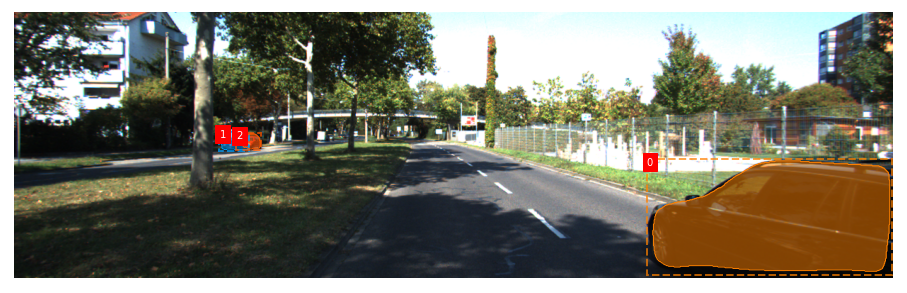

GROUNDTRUTH


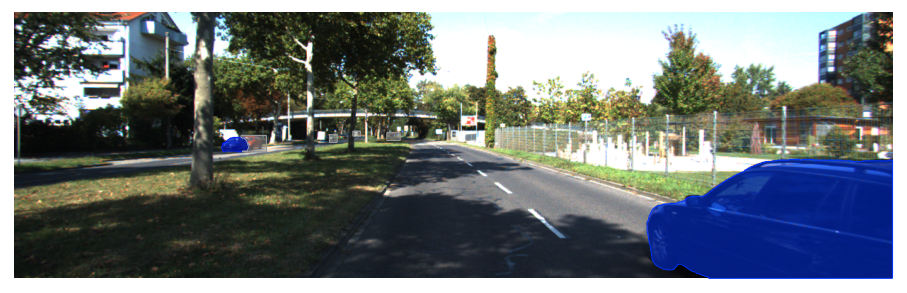

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.4034749888193776
FP -> 0
FN -> 0
M -> 2

**********************************************************************************
FRAME 1
OBJETOS DETECTADOS


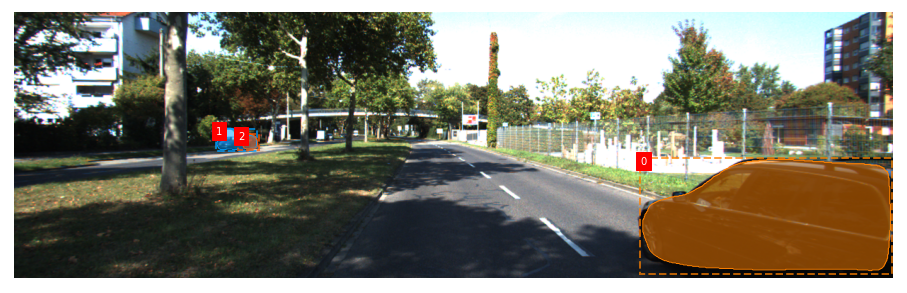

GROUNDTRUTH


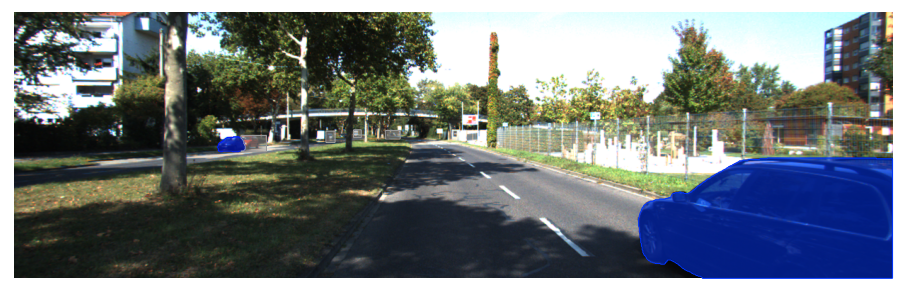

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.2461381733616244
FP -> 0
FN -> 0
M -> 2

**********************************************************************************
FRAME 2
OBJETOS DETECTADOS


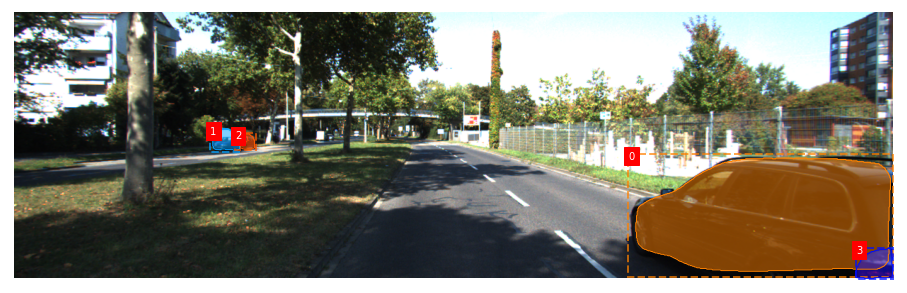

GROUNDTRUTH


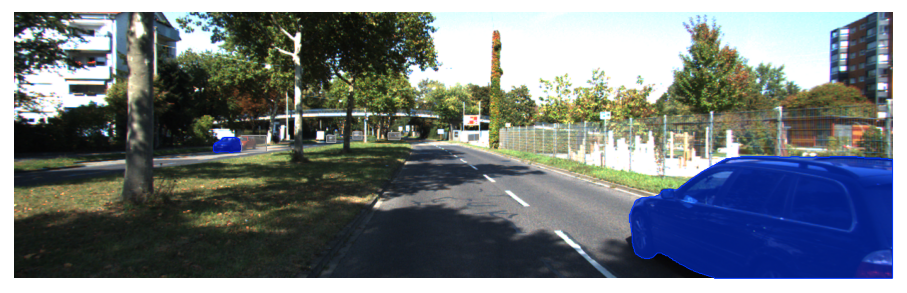

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.326567413097612
FP -> 1
FN -> 0
M -> 2

**********************************************************************************
FRAME 3
OBJETOS DETECTADOS


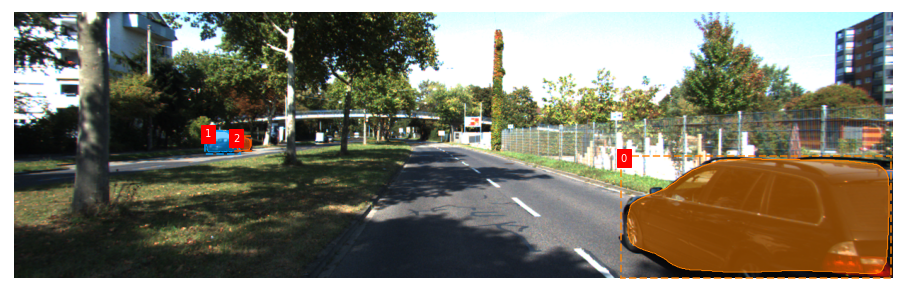

GROUNDTRUTH


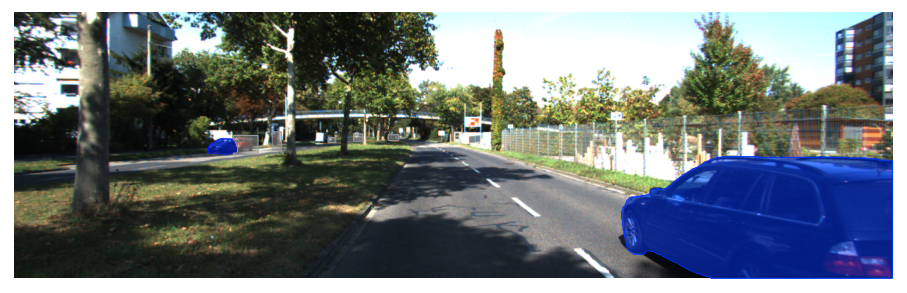

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.3626382390564695
FP -> 0
FN -> 0
M -> 2

**********************************************************************************
FRAME 4
OBJETOS DETECTADOS


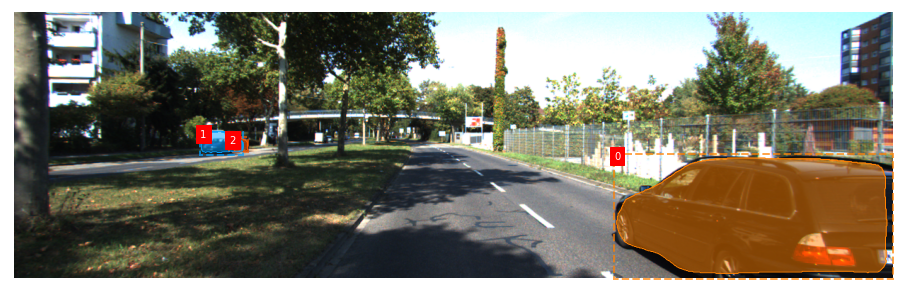

GROUNDTRUTH


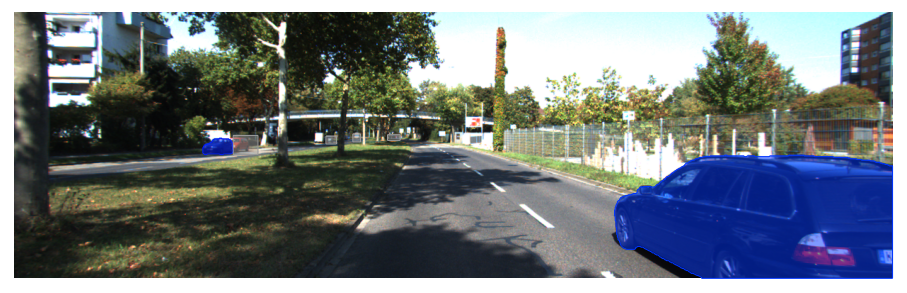

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.3239181497790622
FP -> 0
FN -> 0
M -> 2

**********************************************************************************
FRAME 5
OBJETOS DETECTADOS


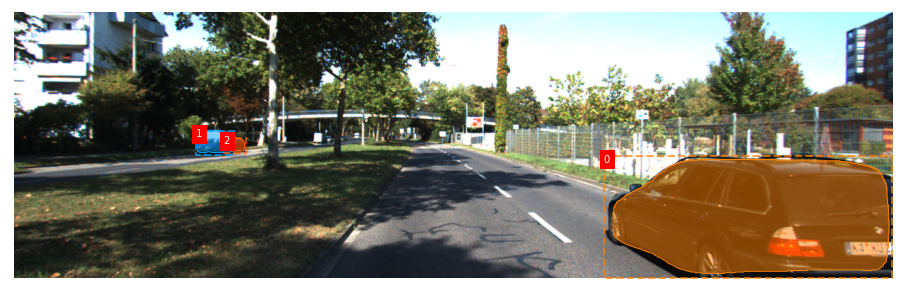

GROUNDTRUTH


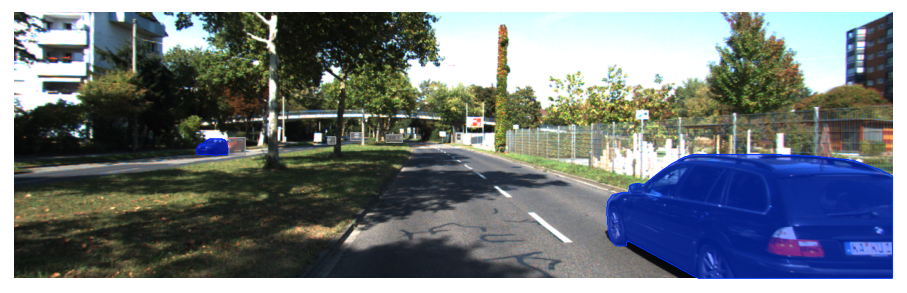

objetosPuntoCiego-> 1
IDS -> 0
TP -> 2
TPS -> 1.3462763334068402
FP -> 0
FN -> 0
M -> 2

**********************************************************************************
FRAME 6
OBJETOS DETECTADOS


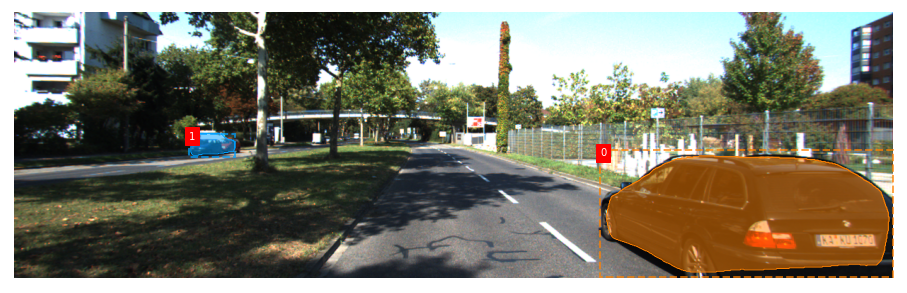

GROUNDTRUTH


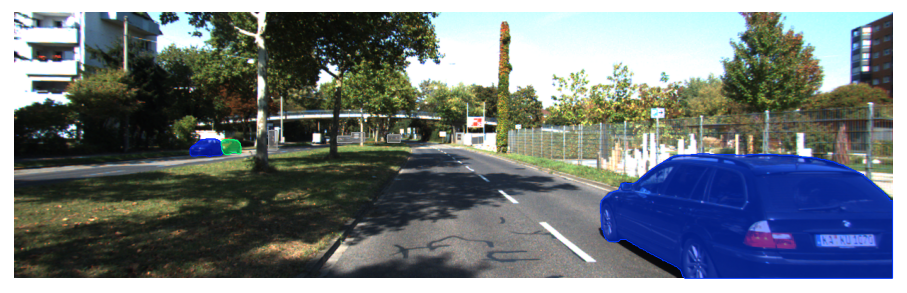

objetosPuntoCiego-> 0
IDS -> 0
TP -> 2
TPS -> 1.3652600360242368
FP -> 0
FN -> 1
M -> 3

**********************************************************************************
FRAME 7
OBJETOS DETECTADOS


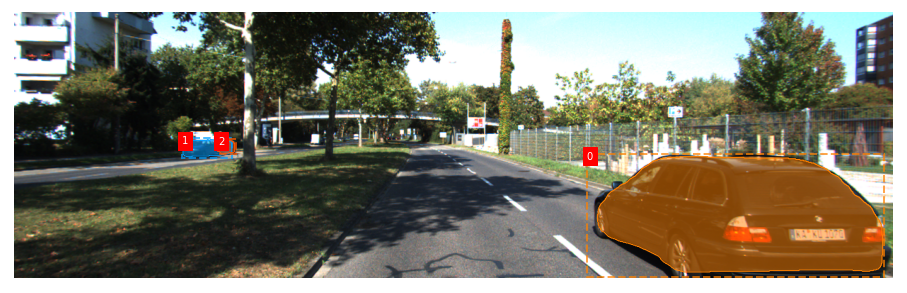

GROUNDTRUTH


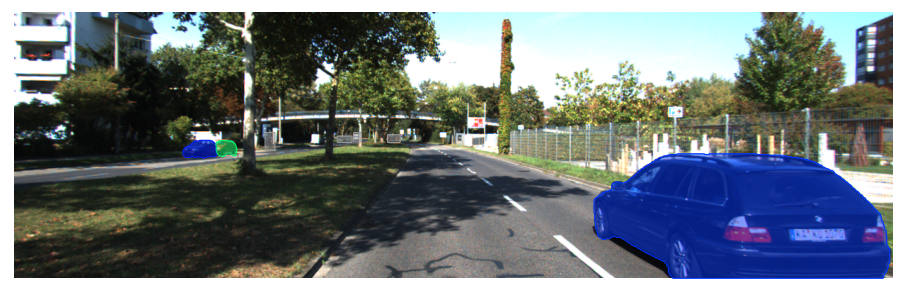

objetosPuntoCiego-> 0
IDS -> 0
TP -> 3
TPS -> 2.1241489076604276
FP -> 0
FN -> 0
M -> 3

**********************************************************************************
FRAME 8
OBJETOS DETECTADOS


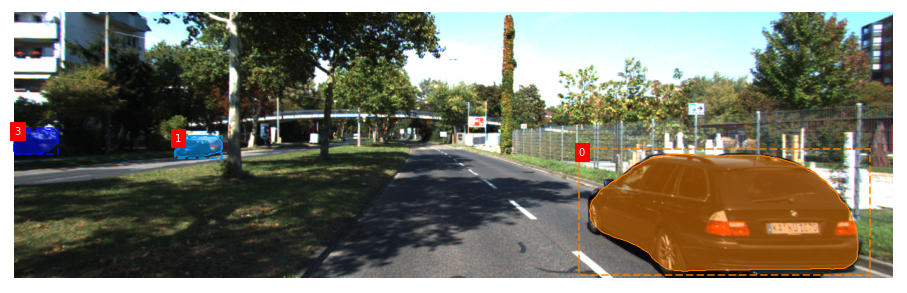

GROUNDTRUTH


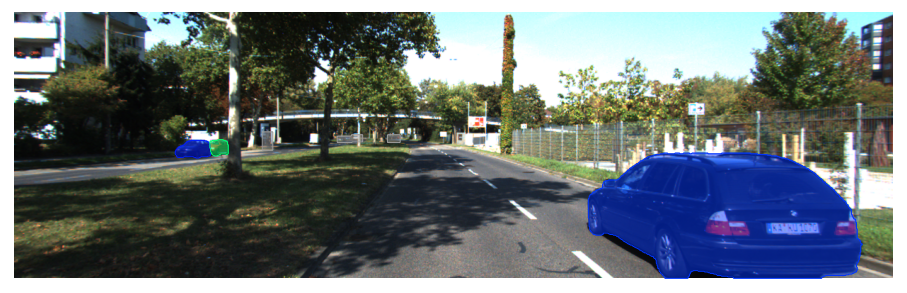

objetosPuntoCiego-> 0
IDS -> 0
TP -> 2
TPS -> 1.4835690412154712
FP -> 1
FN -> 1
M -> 3

**********************************************************************************
FRAME 9
OBJETOS DETECTADOS


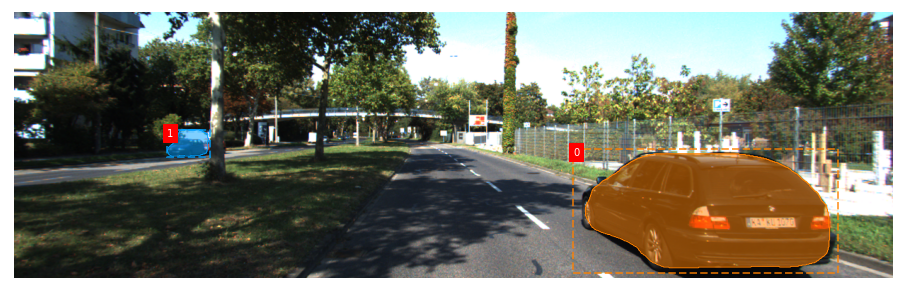

GROUNDTRUTH


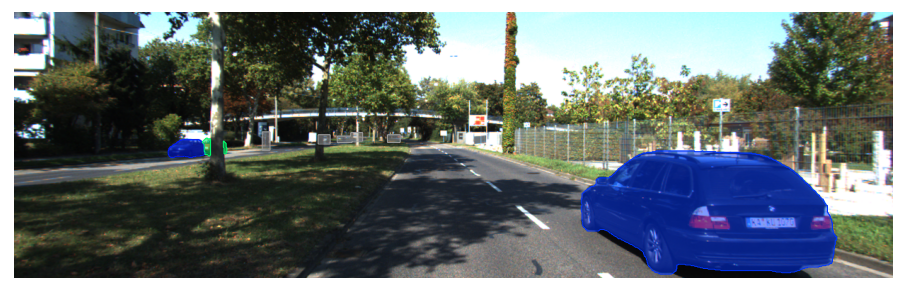

objetosPuntoCiego-> 0
IDS -> 0
TP -> 2
TPS -> 1.481676564168915
FP -> 0
FN -> 1
M -> 3

**********************************************************************************
FRAME 10
OBJETOS DETECTADOS


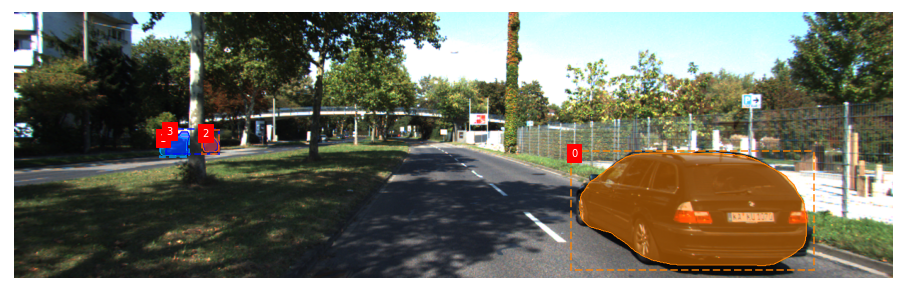

GROUNDTRUTH


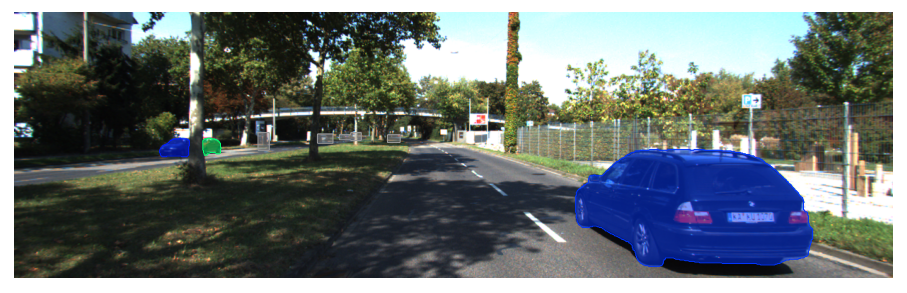

objetosPuntoCiego-> 0
IDS -> 0
TP -> 3
TPS -> 2.2587144172183384
FP -> 1
FN -> 0
M -> 3

**********************************************************************************
FRAME 11
OBJETOS DETECTADOS


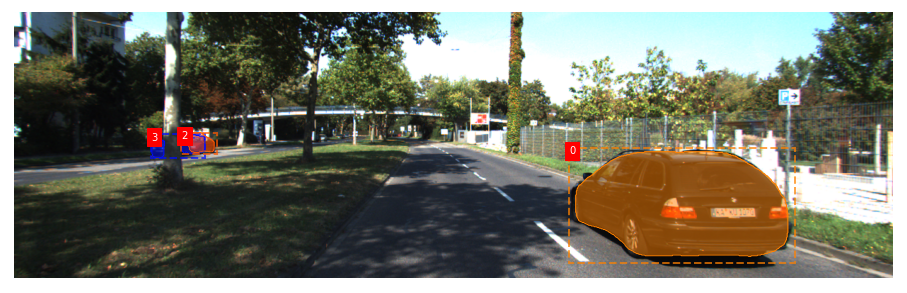

GROUNDTRUTH


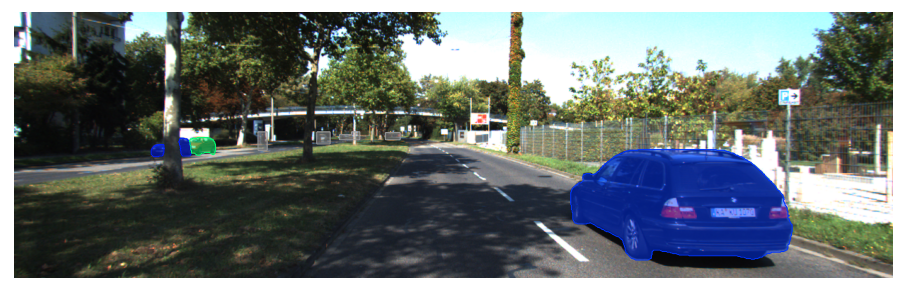

objetosPuntoCiego-> 0
IDS -> 1
TP -> 3
TPS -> 1.9063042851729386
FP -> 0
FN -> 0
M -> 3

**********************************************************************************
FRAME 12
OBJETOS DETECTADOS


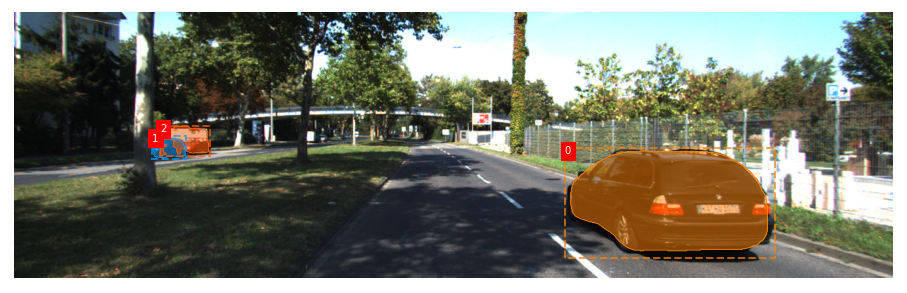

GROUNDTRUTH


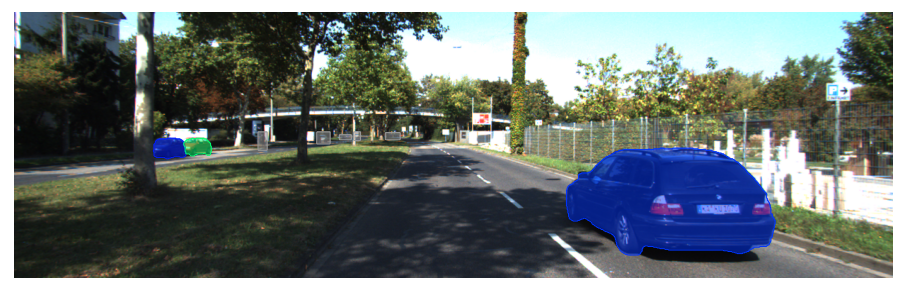

objetosPuntoCiego-> 0
IDS -> 1
TP -> 3
TPS -> 2.0987081273848975
FP -> 0
FN -> 0
M -> 3

**********************************************************************************
FRAME 13
OBJETOS DETECTADOS


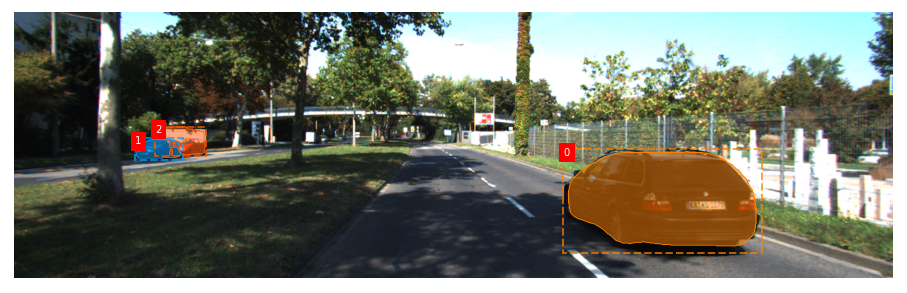

GROUNDTRUTH


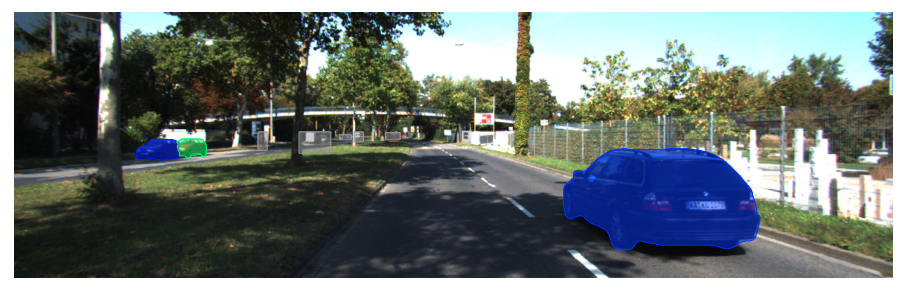

objetosPuntoCiego-> 0
IDS -> 0
TP -> 3
TPS -> 2.1448420644251622
FP -> 0
FN -> 0
M -> 3

**********************************************************************************
FRAME 14
OBJETOS DETECTADOS


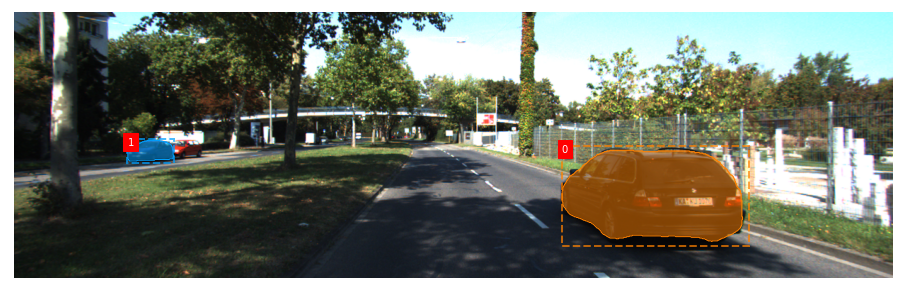

GROUNDTRUTH


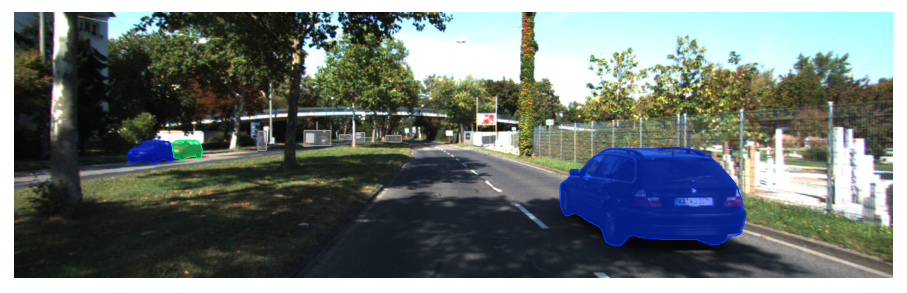

objetosPuntoCiego-> 0
IDS -> 0
TP -> 2
TPS -> 1.781516797395319
FP -> 0
FN -> 1
M -> 3

**********************************************************************************
FRAME 15
OBJETOS DETECTADOS


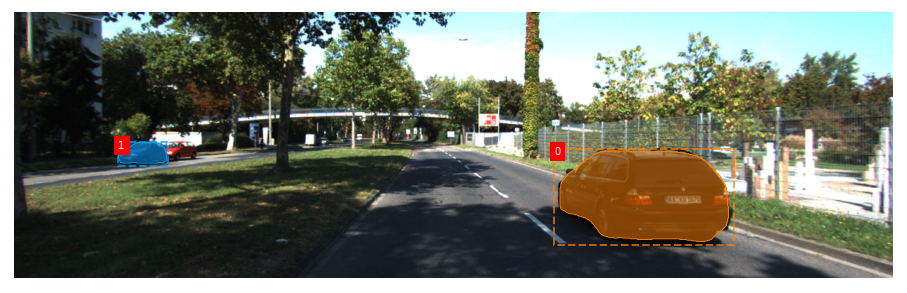

GROUNDTRUTH


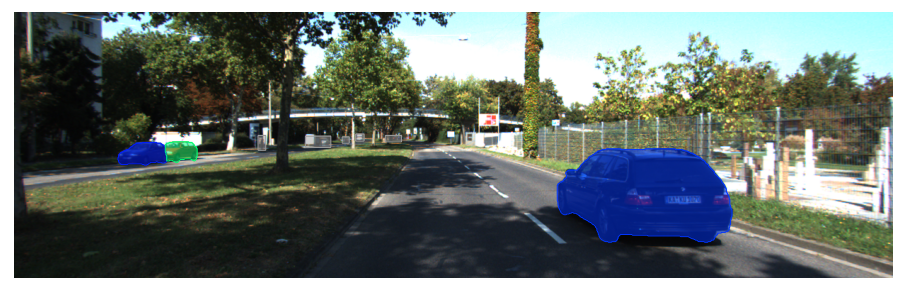

objetosPuntoCiego-> 0
IDS -> 0
TP -> 2
TPS -> 1.82509964076634
FP -> 0
FN -> 1
M -> 3

**********************************************************************************
FRAME 16
OBJETOS DETECTADOS


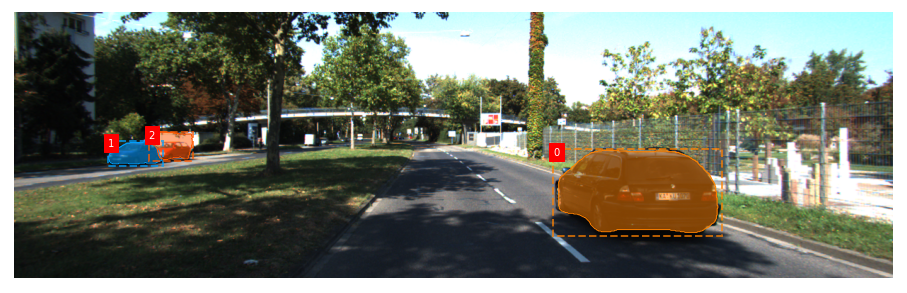

GROUNDTRUTH


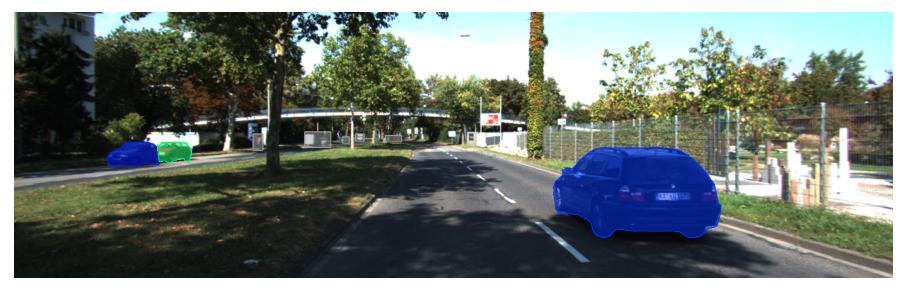

objetosPuntoCiego-> 0
IDS -> 0
TP -> 3
TPS -> 2.2335300967512963
FP -> 0
FN -> 0
M -> 3

**********************************************************************************
FRAME 17


KeyboardInterrupt: 

In [9]:
#modelRAM = tf.keras.models.load_model('redes/model1')  #CARGAR MODELO ENTERO
#modelRAM=[]

modelRAM = createModel()
# Para cargar los pesos hace falta crear un modelo que encaje con la estructura de esos pesos
modelRAM.load_weights("cp-0136.ckpt")

metricasTotal={
             "IDS":0,
             "TP":0,
             "TPS":0,
             "FP":0,
             "FN":0,
             "M":0
            }

'''
DATASET=['0000','0001','0002','0003','0004','0005','0006','0007','0008','0009','0010','0011','0012',
'0013','0014','0015','0016','0018','0019','0020']
'''
#videos que no usa trackrcnn
#DATASET=['0001','0003','0004','0005','0009','0011','0012','0015','0019','0020']

#videos que usa trackrcnn
#DATASET=['0002','0006','0007','0008','0010','0013','0014','0016','0018']

DATASET=['0003']

'''
#PROCESAR UN VIDEO SUELTO SIN GUARDARLO EN NINGUN SITIO
pesoMask=0.8
pesoRAM=0.2
umbral=0.5
pruebas=0
for video in DATASET:
    path = os.path.join(ROOT_DIR, "DATASETS/KITTIMOTS/data_tracking_image_2/training/image_02/"+video)
    lenDATASET=len(os.listdir(path))
    print(lenDATASET)
    objetos,metricasTotal,metricasTRACKRCNN=tracking(modelRAM,video,0,lenDATASET, pesoMask, pesoRAM, umbral, pruebas, metricasTotal, verbose=False)
'''


#PRUEBA DE UN CASO ESPECIFICO
pesoMask=0.8
pesoRAM=0.2
umbral=0
pruebas=1

#while pesoRAM>=0:
for video in DATASET:
    path = os.path.join(ROOT_DIR, "DATASETS/KITTIMOTS/data_tracking_image_2/training/image_02/"+video)
    lenDATASET=len(os.listdir(path))
    print(lenDATASET)
    objetos,metricasTotal=tracking(modelRAM,video,0,lenDATASET, pesoMask, pesoRAM, umbral, pruebas, metricasTotal, verbose=True)

MOTSP=metricas.calcularMOTSP(metricasTotal)
MOTSA=metricas.calcularMOTSA(metricasTotal)
sMOTSA=metricas.calcularSMOTSA(metricasTotal)

print()
print('MOTSP -> ' + str(MOTSP))
print('MOTSA -> ' + str(MOTSA))
print('sMOTSA -> ' + str(sMOTSA))
print()
print('IDS->',metricasTotal['IDS'])
print('TP->',metricasTotal['TP'])
print('TPS->',metricasTotal['TPS'])
print('FP->',metricasTotal['FP'])
print('FN->',metricasTotal['FN'])
print('M->',metricasTotal['M'])

f= open('pruebaVideos/pesosTotal.csv',"a")
data=[[MOTSP,MOTSA,sMOTSA]]
savetxt(f, data, delimiter=',')
f.close()  


'''
metricasTotal['IDS']=0
metricasTotal['TP']=0
metricasTotal['TPS']=0
metricasTotal['FP']=0
metricasTotal['FN']=0
metricasTotal['M']=0
    

pesoMask+=0.1
pesoMask=round(pesoMask,1)
pesoRAM-=0.1
pesoRAM=round(pesoRAM,1)
'''

'''
#PRUEBA DE UN VIDEO HACIENDO TODAS LAS COMBINACIONES DE PESOS 
pesoMask=0
pesoRAM=1
umbral=0.5
pruebas=2

path = os.path.join(ROOT_DIR, "DATASETS/KITTIMOTS/data_tracking_image_2/training/image_02/"+DATASET[0])
lenDATASET=len(os.listdir(path))
while pesoRAM>=0:
    print('pesoRAM->',pesoRAM,' pesoMask->',pesoMask)
    objetos,metricasTotal,metricasTRACKRCNN=tracking(modelRAM,DATASET[0],0,lenDATASET,pesoMask,pesoRAM,umbral,pruebas,metricasTotal,verbose=False)
    pesoMask+=0.1
    pesoMask=round(pesoMask,1)
    pesoRAM-=0.1
    pesoRAM=round(pesoRAM,1)
'''


'''
#PRUEBA DE UN VIDEO PROBANDO CON DISTINTOS UMBRALES PARA ASOCIAR CON OBJEOS DEL GROUNDTRUTH
pesoMask=0.5
pesoRAM=0.5
umbral=0
pruebas=3

while umbral<=0.5:
    print('umbral->',umbral)
    objetos=tracking(modelRAM,DATASET,0,lenDATASET, pesoMask, pesoRAM, umbral, pruebas, verbose=False)
    umbral+=0.1
    umbral=round(umbral,1)
'''
    
print()
print("FIN")

